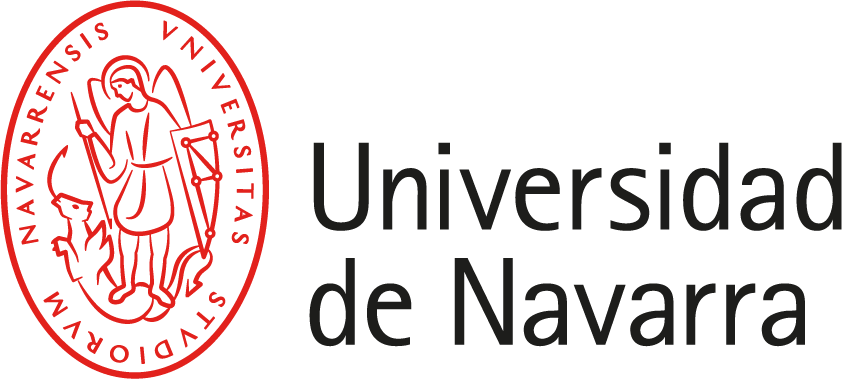

# Estudiante: Michael Murillo Castillo

## Introduccion

Inicialmente tenía previsto utilizar un conjunto de datos de vino para este ejercicio, pero durante la clase, hiciste una observación muy interesante sobre la importancia de trabajar con información que conocemos bien, para poder aplicar nuestro criterio y mejorar aún más el modelo o hacer observaciones valiosas.

Es por esto que decidi hacer mi ejercicio en base football americano. Personalmente no me gusta verlo. Sin embargo, jugué durante 10 años antes de venir a España y estoy consciente del gran problema de lesiones que enfrenta este deporte.

Mi objetivo es desarrollar un modelo capaz de predecir el riesgo de lesiones utilizando diversas variables como el tipo de campo (sintético o natural), posición en el campo o tipo de jugada.

Agradezco el feedback y la motivación para explorar temas poco convencionales!

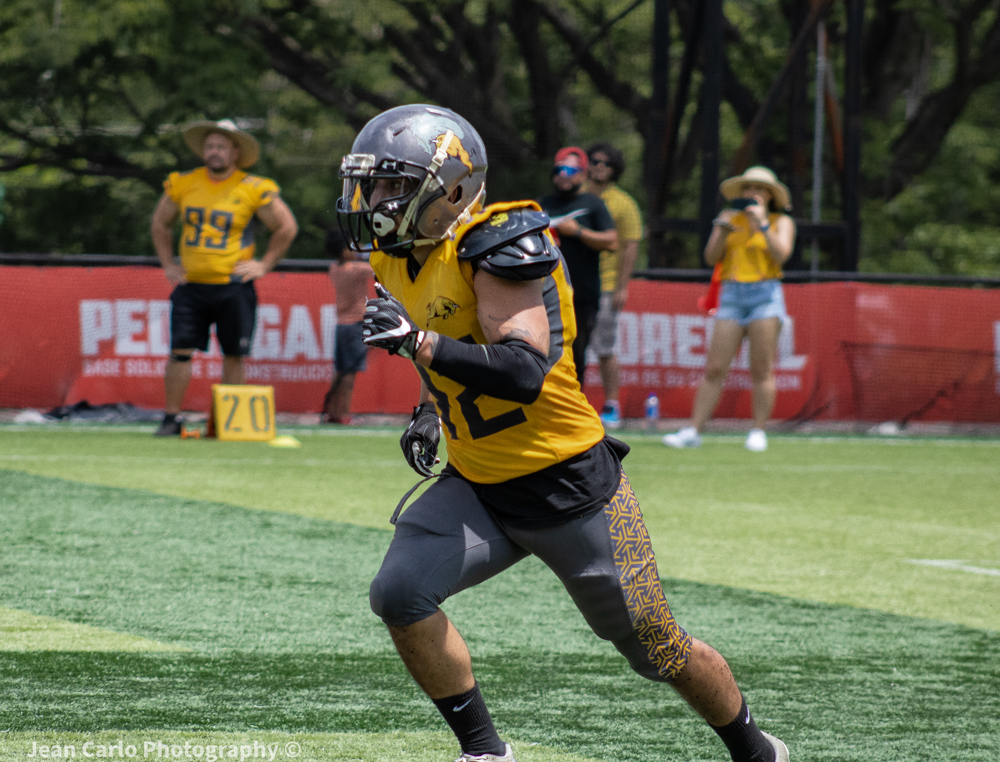

# Objetivo: Identificar las variables más influyentes en las lesiones con el fin de predecir y evaluar el riesgo.

## Data Dictionary

Link para el set de datos: https://www.kaggle.com/competitions/nfl-playing-surface-analytics

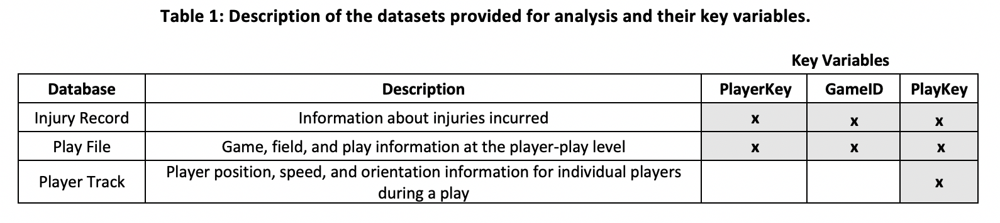

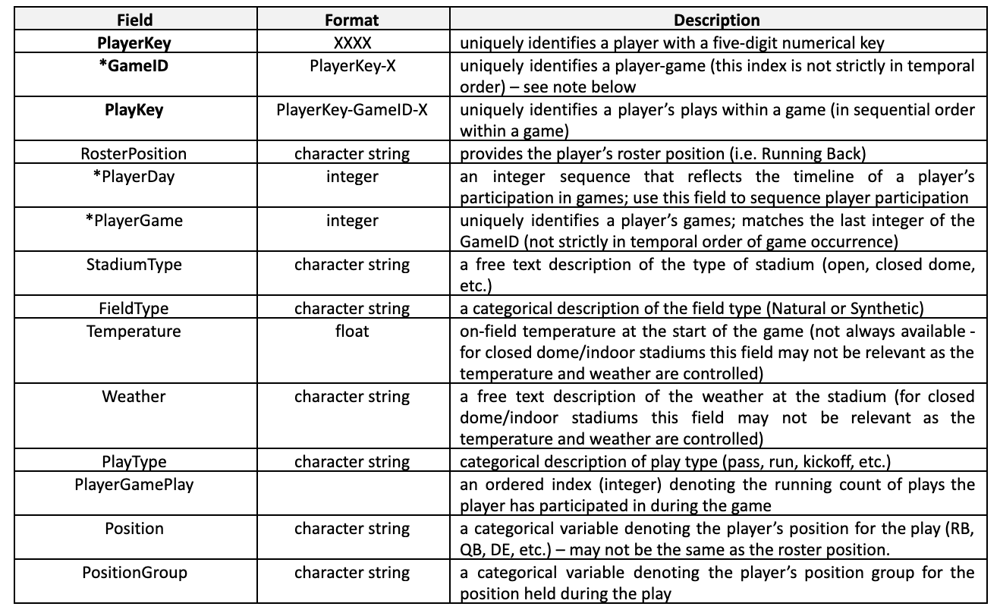

## Carga de datos

In [1]:
import pandas as pd
import seaborn as sns
import pandas
import numpy as np
from pandasgui import show
from time import time

# Load the data files
playlist = pd.read_csv('PlayList.csv')
injuries = pd.read_csv('InjuryRecord.csv')

In [2]:
#Esta libreria la vimos en clase y desde entonces siempre la uso!
#Al inspeccionar el dataset de jugadas, se encuentran que las columnas de clima y tipo de estadio necesitan limpieza.
#No se observan nulls.
show(playlist)

PandasGUI INFO — pandasgui.gui — Opening PandasGUI


In [3]:
#Funcion para limpiar las columnas

def clean_weather(row):
    cloudy = ['Cloudy 50% change of rain', 'Hazy', 'Cloudy.', 'Overcast', 'Mostly Cloudy',
          'Cloudy, fog started developing in 2nd quarter', 'Partly Cloudy',
          'Mostly cloudy', 'Rain Chance 40%',' Partly cloudy', 'Party Cloudy',
          'Rain likely, temps in low 40s', 'Partly Clouidy', 'Cloudy, 50% change of rain','Mostly Coudy', '10% Chance of Rain',
          'Cloudy, chance of rain', '30% Chance of Rain', 'Cloudy, light snow accumulating 1-3"',
          'cloudy', 'Coudy', 'Cloudy with periods of rain, thunder possible. Winds shifting to WNW, 10-20 mph.',
         'Cloudy fog started developing in 2nd quarter', 'Cloudy light snow accumulating 1-3"',
         'Cloudywith periods of rain, thunder possible. Winds shifting to WNW, 10-20 mph.',
         'Cloudy 50% change of rain', 'Cloudy and cold',
       'Cloudy and Cool', 'Partly cloudy']
    
    clear = ['Clear, Windy',' Clear to Cloudy', 'Clear, highs to upper 80s',
             'Clear and clear','Partly sunny',
             'Clear, Windy', 'Clear skies', 'Sunny', 'Partly Sunny', 'Mostly Sunny', 'Clear Skies',
             'Sunny Skies', 'Partly clear', 'Fair', 'Sunny, highs to upper 80s', 'Sun & clouds', 'Mostly sunny','Sunny, Windy',
             'Mostly Sunny Skies', 'Clear and Sunny', 'Clear and sunny','Clear to Partly Cloudy', 'Clear Skies',
            'Clear and cold', 'Clear and warm', 'Clear and Cool', 'Sunny and cold', 'Sunny and warm', 'Sunny and clear']
    
    rainy = ['Rainy', 'Scattered Showers', 'Showers', 'Cloudy Rain', 'Light Rain', 'Rain shower', 'Rain likely, temps in low 40s.', 'Cloudy, Rain']
    
    snow = ['Heavy lake effect snow']
    
    indoor = ['Controlled Climate', 'Indoors', 'N/A Indoor', 'N/A (Indoors)']
        
    if row.Weather in cloudy:
        return 'Cloudy'
    
    if row.Weather in indoor:
        return 'Indoor'
    
    if row.Weather in clear:
        return 'Clear'
    
    if row.Weather in rainy:
        return 'Rain'
    
    if row.Weather in snow:
        return 'Snow'
      
    if row.Weather in ['Cloudy.', 'Heat Index 95', 'Cold']:
        return np.nan
    
    return row.Weather

#def clean_stadiumtype(row):
#    if row.StadiumType in ['Bowl', 'Heinz Field', 'Cloudy']:
#        return np.nan
#    else:
#        return row.StadiumType

def clean_play_df(play_df):
    play_df_cleaned = play_df.copy()
    
    # clean StadiumType
#    play_df_cleaned = play_df_cleaned['StadiumType'].str.replace(r'Oudoor|Outdoors|Ourdoor|Outddors|Outdor|Outside', 'Outdoor')
#    play_df_cleaned['StadiumType'] = play_df_cleaned['StadiumType'].str.replace(r'Indoors|Indoor, Roof Closed|Indoor, Open Roof', 'Indoor')
#    play_df_cleaned['StadiumType'] = play_df_cleaned['StadiumType'].str.replace(r'Closed Dome|Domed, closed|Domed, Open|Domed, open|Dome, closed|Domed', 'Dome')
#    play_df_cleaned['StadiumType'] = play_df_cleaned['StadiumType'].str.replace(r'Retr. Roof-Closed|Outdoor Retr Roof-Open|Retr. Roof - Closed|Retr. Roof-Open|Retr. Roof - Open|Retr. Roof Closed', 'Retractable Roof')
#    play_df_cleaned['StadiumType'] = play_df_cleaned['StadiumType'].str.replace('Open', 'Outdoor')
#    play_df_cleaned['StadiumType'] = play_df_cleaned.apply(lambda row: clean_stadiumtype(row), axis=1)
    
    # clean Weather
    play_df_cleaned['Weather'] = play_df_cleaned.apply(lambda row: clean_weather(row), axis=1)
    
    return play_df_cleaned

In [4]:
#Creo un dataset con las columnas anteriormente mencionadas limpias.
clean_df = clean_play_df(playlist)
clean_df.head()

,PlayerKey,GameID,PlayKey,RosterPosition,PlayerDay,PlayerGame,StadiumType,FieldType,Temperature,Weather,PlayType,PlayerGamePlay,Position,PositionGroup
0,26624,26624-1,26624-1-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,1,QB,QB
1,26624,26624-1,26624-1-2,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,2,QB,QB
2,26624,26624-1,26624-1-3,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Rush,3,QB,QB
3,26624,26624-1,26624-1-4,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Rush,4,QB,QB
4,26624,26624-1,26624-1-5,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,5,QB,QB


In [5]:
#En este paso, agregue el registro de lesiones a nuestro dataset de jugadas. Ya con esto podemos_
#obtener la jugada en la que ocurrio la lesion
df = pd.merge(clean_df, injuries,on=['PlayerKey', 'GameID', 'PlayKey'],how ='left')
df.set_index("PlayKey", inplace= True)
df.head()

,PlayerKey,GameID,RosterPosition,PlayerDay,PlayerGame,StadiumType,FieldType,Temperature,Weather,PlayType,PlayerGamePlay,Position,PositionGroup,BodyPart,Surface,DM_M1,DM_M7,DM_M28,DM_M42
PlayKey,,,,,,,,,,,,,,,,,,,
26624-1-1,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,1,QB,QB,NaN,NaN,NaN,NaN,NaN,NaN
26624-1-2,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,2,QB,QB,NaN,NaN,NaN,NaN,NaN,NaN
26624-1-3,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Rush,3,QB,QB,NaN,NaN,NaN,NaN,NaN,NaN
26624-1-4,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Rush,4,QB,QB,NaN,NaN,NaN,NaN,NaN,NaN
26624-1-5,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,5,QB,QB,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
#Todo pinta bien hasta ahora!
show(df)

PandasGUI INFO — pandasgui.gui — Opening PandasGUI


In [7]:
#Crearé un conjunto de datos adicional que estará compuesto por la misma unión de datos,_ 
#pero solo incluirá información sobre las lesiones.
inj_df = df[df['BodyPart'].notnull()]

## EDA (Exploratory Data Analysis)

En esta sección, voy a presentar visualmente aquellos factores que, como ex jugador, intuyo que pueden estar relacionados con la variable objetivo (Lesiones) utilizando la libreria Seaborn.

In [8]:
#Doy formato a mis visualizaciones
sns.set(rc={'figure.figsize':(11.7,8.27)})
diverging_colors = sns.color_palette("RdBu", 10)

<AxesSubplot: xlabel='Weather', ylabel='count'>

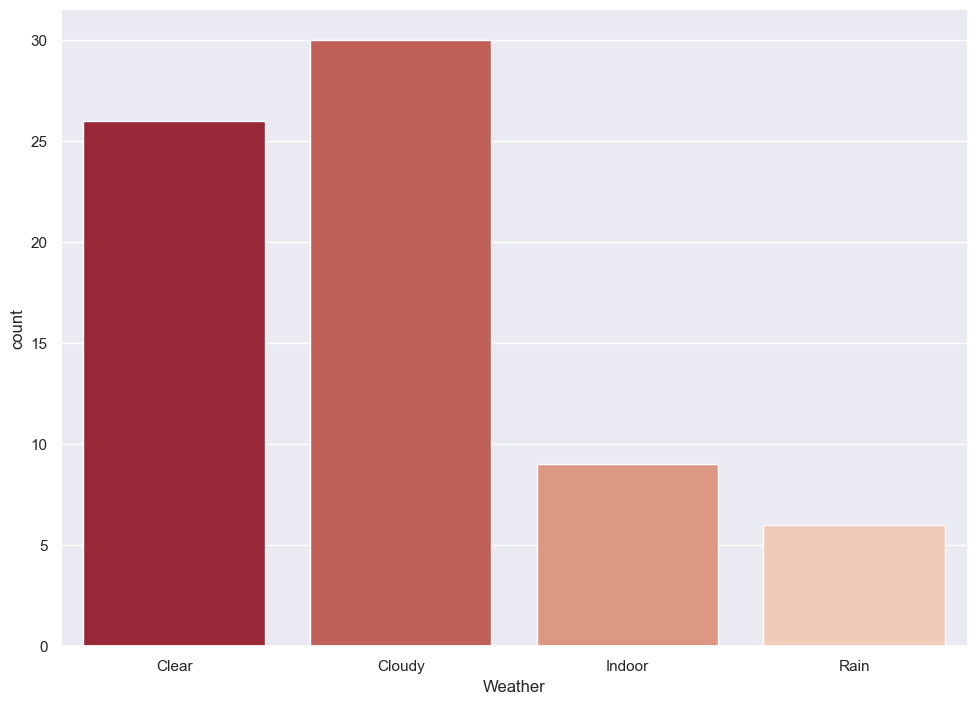

In [9]:
sns.countplot(x = 'Weather', data = inj_df, palette = diverging_colors)

<AxesSubplot: xlabel='PlayType', ylabel='count'>

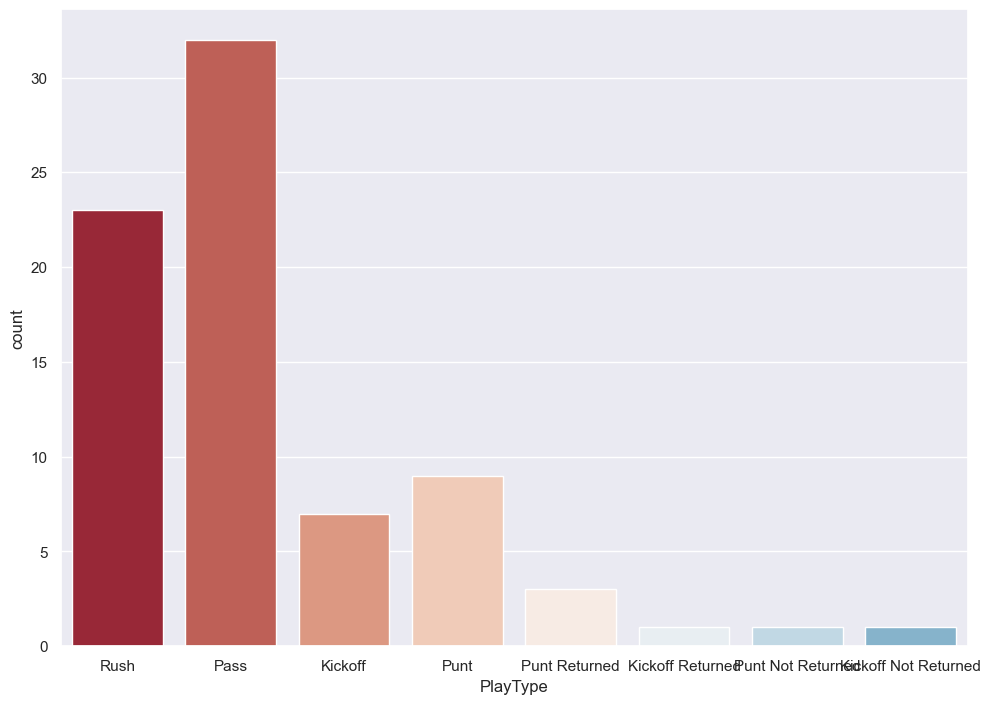

In [10]:
sns.countplot(x = 'PlayType', data = inj_df, palette = diverging_colors)

Esta visualizacion nos indica la catidad de veces que hubieron lesiones por tipo de jugada. Es evidente que un gran numero de lesiones ocurren durante una jugada de pase pero en el football americano y especialmente en la NFL, la mayoria de jugadas son pase.

En promedio, en un partido de football ocurren solo 3.4 PUNTS por partido. Al igual que los kickofss, ocurren muy pocas veces por partido como para tener un numero tan alto de lesiones.

Voy a visualizar la proporcion de lesiones en torno a la cantidad de jugadas para confirmar mi teoria.

In [11]:
group = df.groupby(['PlayType']).count()
injury_ratio = pd.DataFrame(group)
injury_ratio['Injury % per play'] = (injury_ratio['BodyPart'] / injury_ratio['PlayerKey'])*100
injury_ratio = injury_ratio.sort_values('Injury % per play', ascending= False)

<AxesSubplot: xlabel='PlayType', ylabel='Injury % per play'>

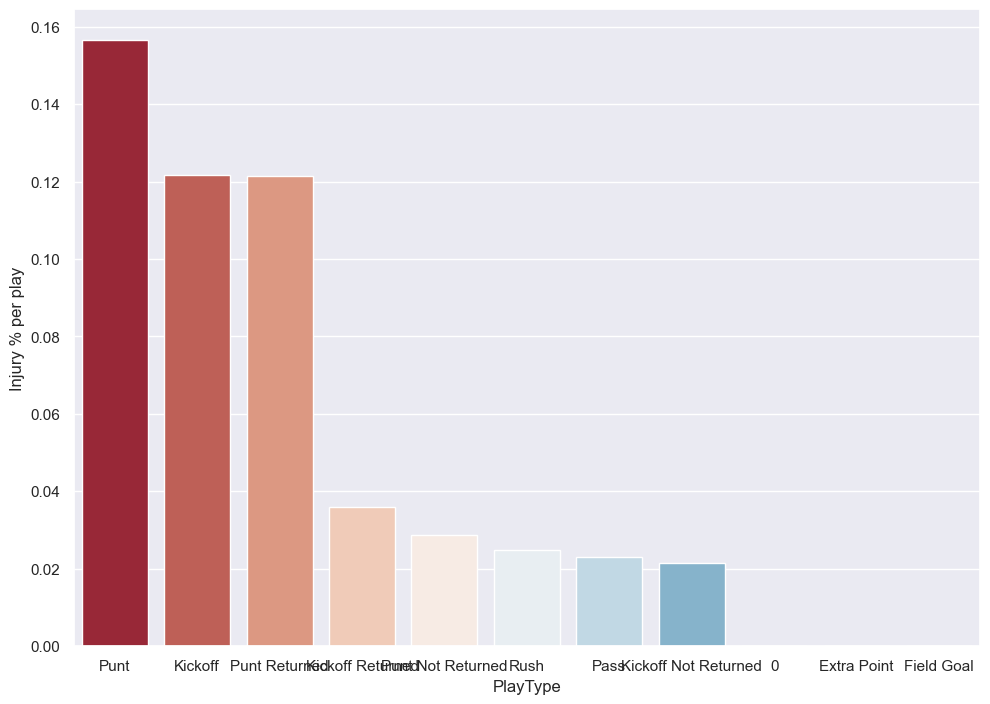

In [12]:
sns.barplot(x = injury_ratio.index,  y='Injury % per play', data=injury_ratio, estimator=sum, palette = diverging_colors)

Ahora se aprecia mucho mejor que en las jugadas de Punt y Kickoff existe una mayor proporción de lesiones. ¿Por qué ocurre esto?

Bueno, en las jugadas de Punt y Kickoff, el equipo que posee el balón lo patea hacia el equipo contrario, y este último debe correr por toda la cancha para atrapar el balón y llevarlo al campo contrario. En estas jugadas, los jugadores corren a altas velocidades y se producen colisiones violentas que, en muchos casos, pueden resultar en lesiones.

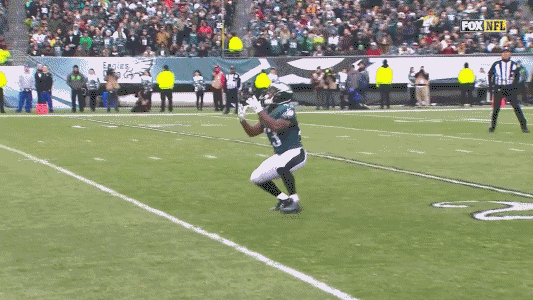

<AxesSubplot: xlabel='BodyPart', ylabel='count'>

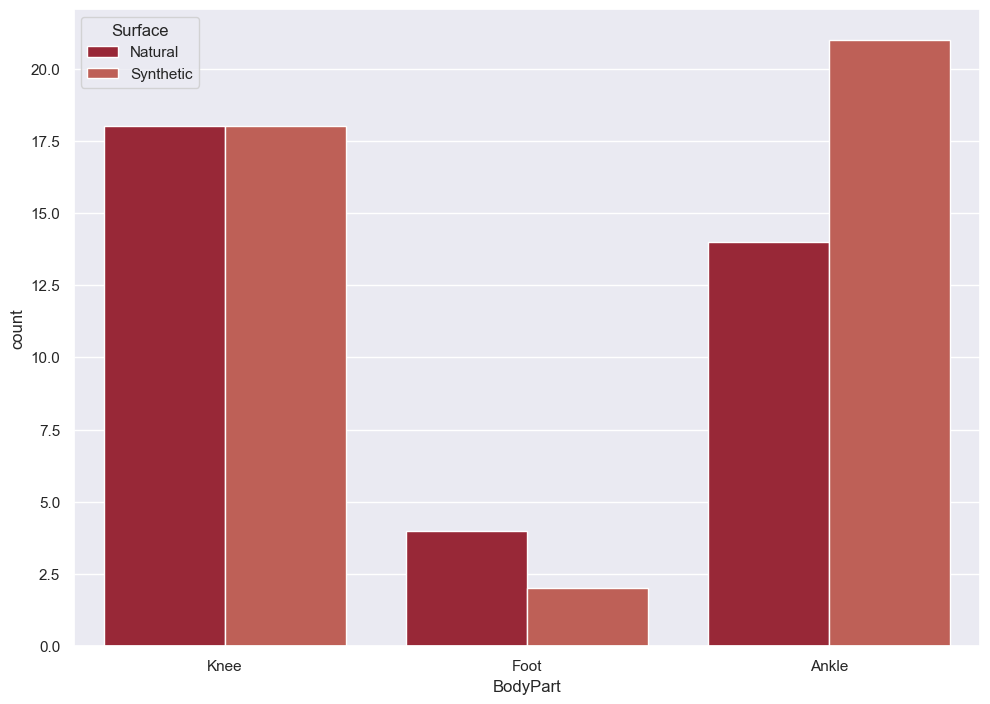

In [13]:
sns.countplot(data=inj_df, x='BodyPart', hue= 'Surface', palette=diverging_colors)

Otro factor que suele influir mucho en las lesiones es el tipo de gramilla. No vemos tanta variacion del tipo de gramilla en relacion a la zona de la lesion excepto en lesiones de tobillo.

<AxesSubplot: xlabel='RosterPosition', ylabel='count'>

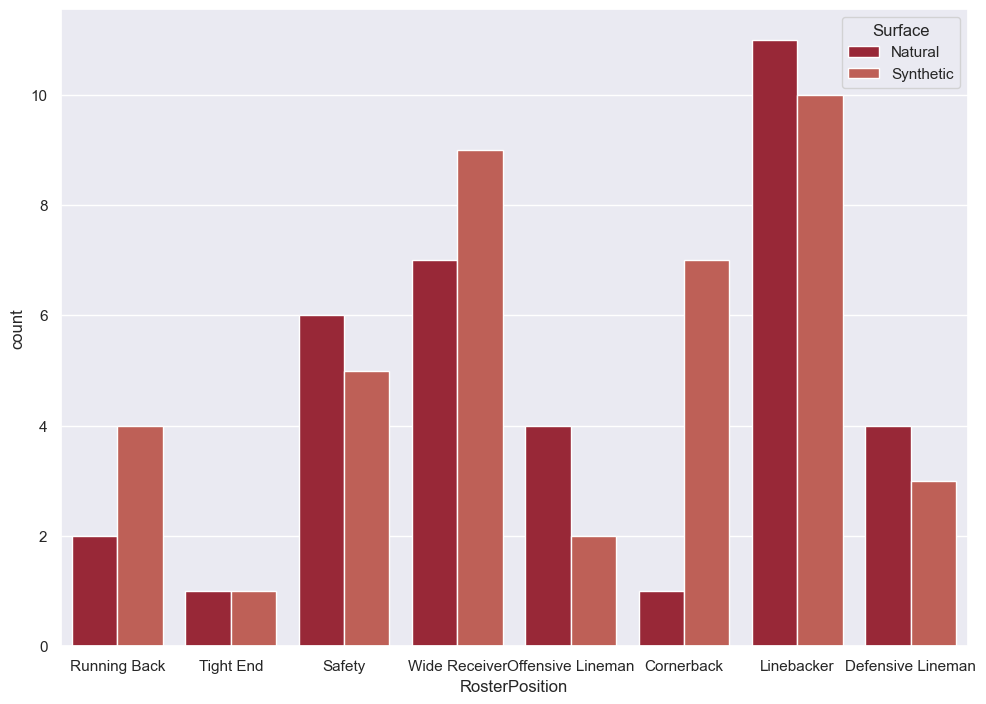

In [14]:
sns.countplot(data=inj_df, x='RosterPosition', hue= 'Surface', palette=diverging_colors)

Utilizamos lo misma logica pero en base a la posicion, y esta vez encontramos que los Cornerbacks sufren mucho mas lesiones en comparacion a las otras posiciones cuando se juega en gramilla sintetica.

En particular, los Cornerbacks, Running Backs y Wide Receivers a menudo tienen que realizar movimientos repentinos y rápidos, como cortes y cambios de dirección, lo que puede poner mucho estrés en sus rodillas y tobillos. En el césped sintético, este estrés se magnifica debido a la superficie más dura y la falta de amortiguación, lo que aumenta el riesgo de lesiones. La posicion que jugue durante 10 años fue Cornerback, es por esto que intui que podia existir una relacion entre tipo de gramilla y posicion.

Otra observacion es que la posicion con mas lesiones es la de Linebacker! No es de sorpresa ya que es la posicion mas demandante fisicamente en el juego.

Voy a explorar un poco mas los tipos de lesion en las posiciones RB (Running Back), WR (Wide Receiver) y CB (Cornerback) en gramilla sintetica.

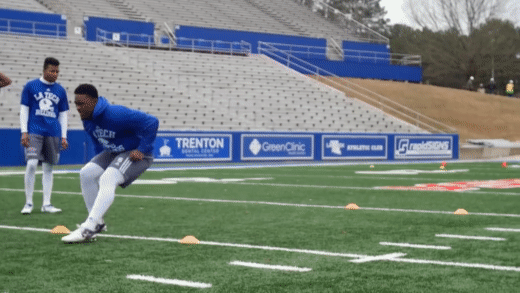

<AxesSubplot: xlabel='RosterPosition', ylabel='count'>

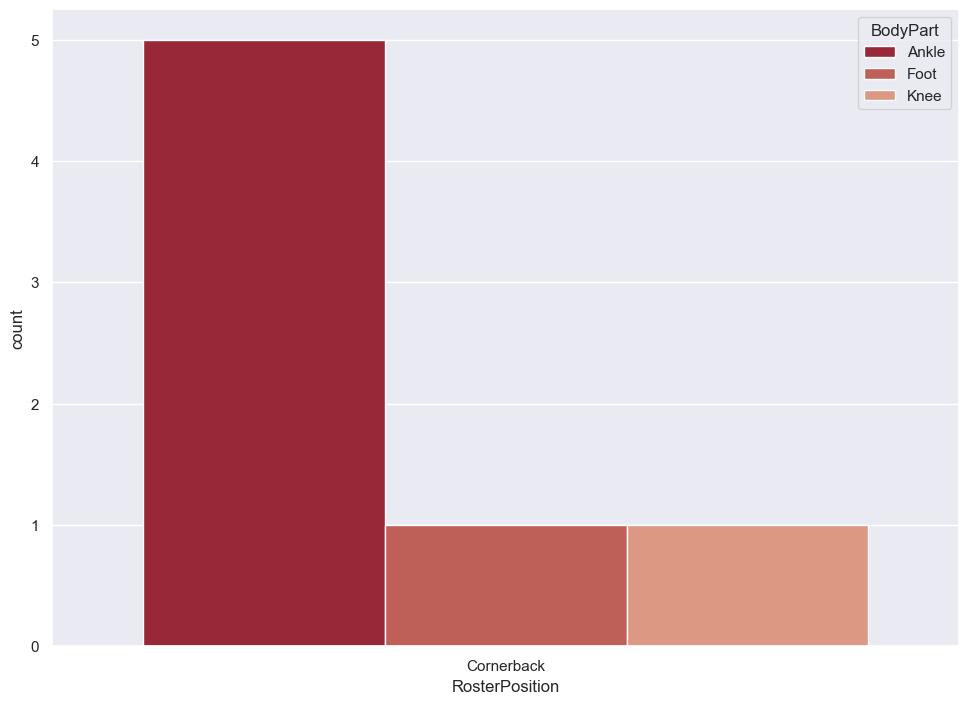

In [15]:
synturf_df = inj_df[inj_df["Surface"]== "Synthetic"]
CB = synturf_df[synturf_df["RosterPosition"]== "Cornerback"]
sns.countplot(data=CB, x='RosterPosition', hue= 'BodyPart', palette=diverging_colors)

Evidentemente la mayoria de las lesiones para los CBs en gramilla sintetica ocurre en los tobillos.

<AxesSubplot: xlabel='RosterPosition', ylabel='count'>

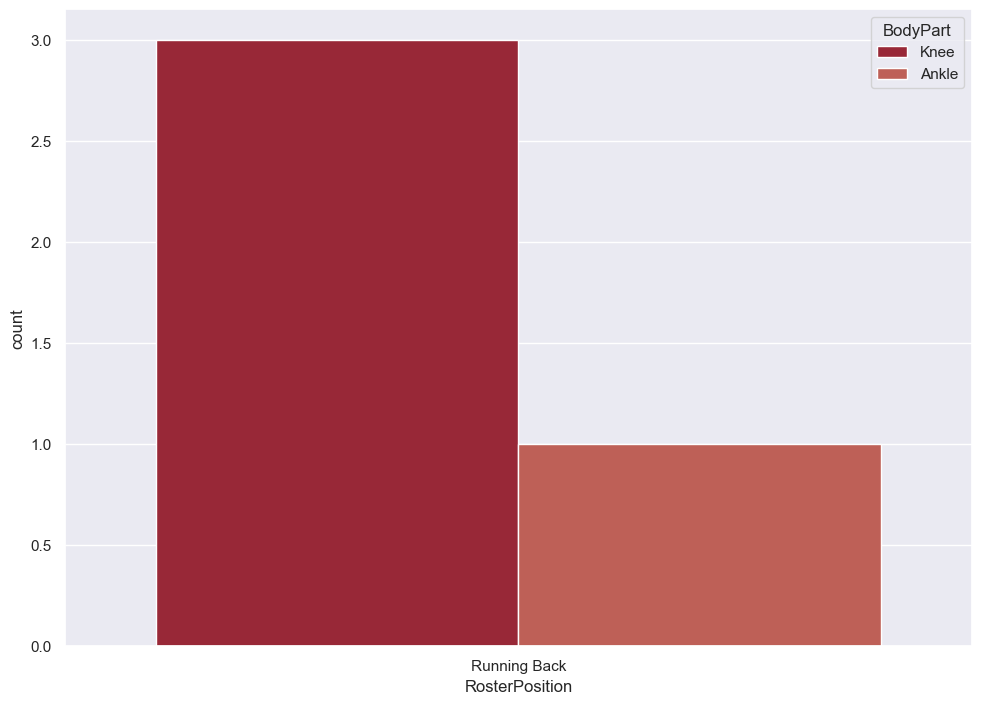

In [16]:
RB = synturf_df[synturf_df["RosterPosition"]== "Running Back"]
sns.countplot(data=RB, x='RosterPosition', hue= 'BodyPart', palette=diverging_colors)

<AxesSubplot: xlabel='RosterPosition', ylabel='count'>

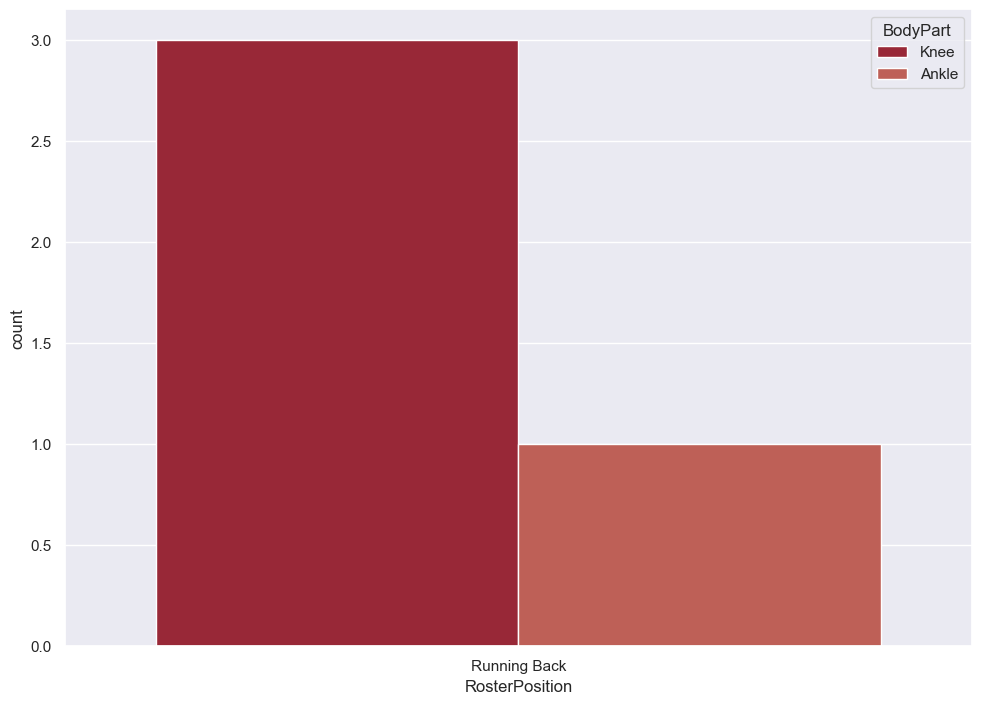

In [17]:
WR = synturf_df[synturf_df["RosterPosition"]== "Wide Receiver"]
sns.countplot(data=RB, x='RosterPosition', hue= 'BodyPart', palette=diverging_colors)

En posiciones ofensivas como lo son RB y WR, las lesiones ocurren mas en las rodillas. Esto se puede deber al impacto de las rodillas contra el suelo durante un tacleo.

Por ultimo, voy a hacer un heatmap de correlacion para visualizar otras posibles variables que influyan en las lesiones. Para llevar a cabo esto, necesitamos aplicar encoding a las variables categorias como posicion, lesion o tipo de gramilla.

### Dummy Variables

En esta sección, crearé variables ficticias (Dummy Variables) para las variables que han tenido mayor impacto en la variable de lesión, con el propósito de utilizarlas más adelante.

In [18]:
#Dummy para el tipo de jugada
dummy_playtype = pd.get_dummies(df.PlayType, prefix='PlayType')
dummy_playtype.head()
final_df = df.join(dummy_playtype)

In [19]:
#Dummy para posicion
dummy_RosterPosition = pd.get_dummies(df.RosterPosition, prefix='RosterPosition')
dummy_RosterPosition.head()
final_df = final_df.join(dummy_RosterPosition)

In [20]:
#Dummy para gramilla
dummy_Surface = pd.get_dummies(df.Surface, prefix='Surface')
dummy_Surface.head()
final_df = final_df.join(dummy_Surface)

In [21]:
#Confirmamos que las columnas se han añadido al dataset satisfactoriamente.
final_df.columns

Index(['PlayerKey', 'GameID', 'RosterPosition', 'PlayerDay', 'PlayerGame',
       'StadiumType', 'FieldType', 'Temperature', 'Weather', 'PlayType',
       'PlayerGamePlay', 'Position', 'PositionGroup', 'BodyPart', 'Surface',
       'DM_M1', 'DM_M7', 'DM_M28', 'DM_M42', 'PlayType_0',
       'PlayType_Extra Point', 'PlayType_Field Goal', 'PlayType_Kickoff',
       'PlayType_Kickoff Not Returned', 'PlayType_Kickoff Returned',
       'PlayType_Pass', 'PlayType_Punt', 'PlayType_Punt Not Returned',
       'PlayType_Punt Returned', 'PlayType_Rush', 'RosterPosition_Cornerback',
       'RosterPosition_Defensive Lineman', 'RosterPosition_Kicker',
       'RosterPosition_Linebacker', 'RosterPosition_Offensive Lineman',
       'RosterPosition_Quarterback', 'RosterPosition_Running Back',
       'RosterPosition_Safety', 'RosterPosition_Tight End',
       'RosterPosition_Wide Receiver', 'Surface_Natural', 'Surface_Synthetic'],
      dtype='object')

In [22]:
#Agrego una columna nueva que indique si hubo o no lesion en la jugada.
final_df['Injury'] = np.where(final_df.BodyPart.notnull(), 1, 0)
final_df

,PlayerKey,GameID,RosterPosition,PlayerDay,PlayerGame,StadiumType,FieldType,Temperature,Weather,PlayType,...,RosterPosition_Linebacker,RosterPosition_Offensive Lineman,RosterPosition_Quarterback,RosterPosition_Running Back,RosterPosition_Safety,RosterPosition_Tight End,RosterPosition_Wide Receiver,Surface_Natural,Surface_Synthetic,Injury
PlayKey,,,,,,,,,,,,,,,,,,,,,
26624-1-1,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,...,0,0,1,0,0,0,0,0,0,0
26624-1-10,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,...,0,0,1,0,0,0,0,0,0,0
26624-1-11,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Rush,...,0,0,1,0,0,0,0,0,0,0
26624-1-12,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,...,0,0,1,0,0,0,0,0,0,0
26624-1-13,26624,26624-1,Quarterback,1,1,Outdoor,Synthetic,63,Clear,Pass,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47888-9-54,47888,47888-9,Cornerback,71,9,Outdoor,Synthetic,53,Cloudy,Pass,...,0,0,0,0,0,0,0,0,0,0
47888-9-6,47888,47888-9,Cornerback,71,9,Outdoor,Synthetic,53,Cloudy,Pass,...,0,0,0,0,0,0,0,0,0,0
47888-9-7,47888,47888-9,Cornerback,71,9,Outdoor,Synthetic,53,Cloudy,Rush,...,0,0,0,0,0,0,0,0,0,0


Ya casi tenemos el dataset listo, a continuacion voy a eliminar columnas que no han tenido mucho impacto en la variable objetivo o aquellas que no sean numericas.

Las columnas DM indican la cantidad de días que tomó regresar a jugar después de la lesión. Las eliminaré porque no creo que aporten mucho valor, ya que reflejan el resultado posterior a la lesión.

In [24]:
final_df_int = final_df.select_dtypes(exclude=['object'])
final_df_int.drop(columns = ['DM_M1', 'DM_M7', 'DM_M28', 'DM_M42', 'PlayerKey', 'PlayerDay', 'Temperature', 'PlayerGamePlay', 'PlayerGame'], axis= 0, inplace=True)
final_df_int

,PlayType_0,PlayType_Extra Point,PlayType_Field Goal,PlayType_Kickoff,PlayType_Kickoff Not Returned,PlayType_Kickoff Returned,PlayType_Pass,PlayType_Punt,PlayType_Punt Not Returned,PlayType_Punt Returned,...,RosterPosition_Linebacker,RosterPosition_Offensive Lineman,RosterPosition_Quarterback,RosterPosition_Running Back,RosterPosition_Safety,RosterPosition_Tight End,RosterPosition_Wide Receiver,Surface_Natural,Surface_Synthetic,Injury
PlayKey,,,,,,,,,,,,,,,,,,,,,
26624-1-1,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,0,0,0
26624-1-10,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,0,0,0
26624-1-11,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
26624-1-12,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,0,0,0
26624-1-13,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47888-9-54,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
47888-9-6,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
47888-9-7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Ya que tenemos el dataset con solo variables numericas y dicotomicas, pasaremos a la reduccion de dimensionalidad.

## REDUCCIÓN DE LA DIMENSONALIDAD


En esta sección, emplearé distintos métodos de selección de variables para identificar aquellas que tengan mayor influencia sobre nuestra variable objetivo.

<AxesSubplot: >

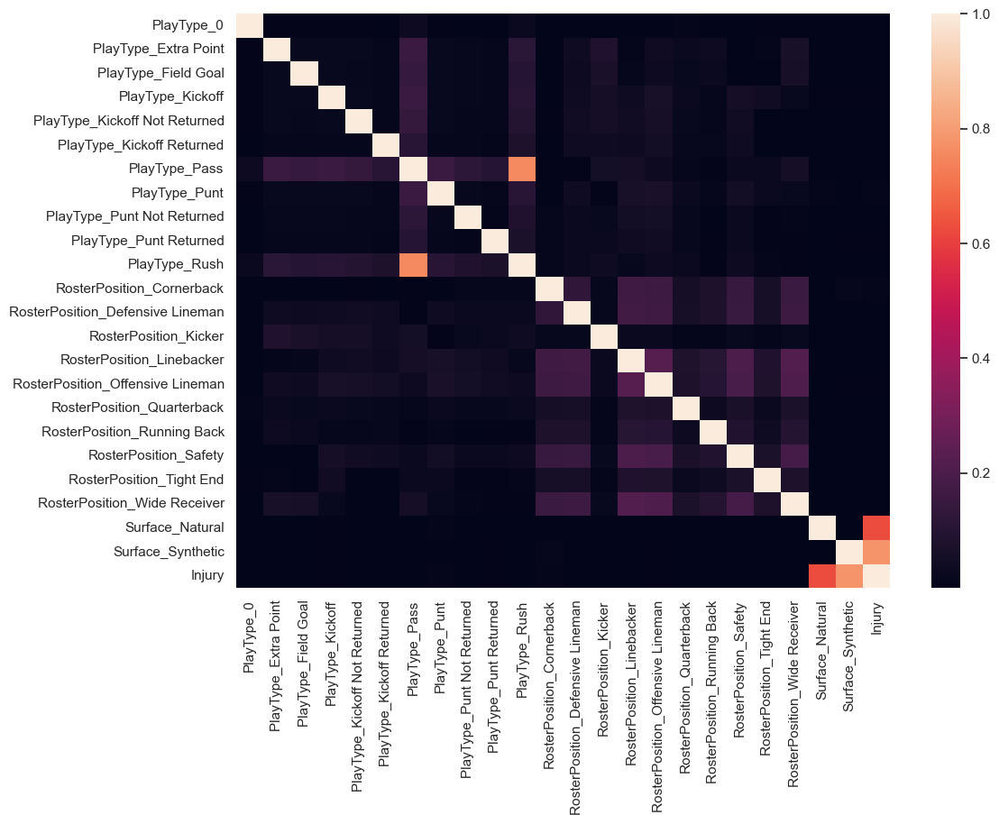

In [30]:
corr = final_df_int.corr().abs()
sns.heatmap(data= corr)

No pinta muy bien. Esto podría deberse a la falta de datos en nuestro conjunto de datos que representan lesiones. Actualmente, las únicas variables que muestran alguna correlación son las relacionadas con el tipo de césped utilizado.

In [35]:
upper_tri = corr.where(np.triu(np.ones(corr.shape),k=1).astype(np.bool))
print(upper_tri)

                                  PlayType_0  PlayType_Extra Point  \
PlayType_0                               NaN              0.004864   
PlayType_Extra Point                     NaN                   NaN   
PlayType_Field Goal                      NaN                   NaN   
PlayType_Kickoff                         NaN                   NaN   
PlayType_Kickoff Not Returned            NaN                   NaN   
PlayType_Kickoff Returned                NaN                   NaN   
PlayType_Pass                            NaN                   NaN   
PlayType_Punt                            NaN                   NaN   
PlayType_Punt Not Returned               NaN                   NaN   
PlayType_Punt Returned                   NaN                   NaN   
PlayType_Rush                            NaN                   NaN   
RosterPosition_Cornerback                NaN                   NaN   
RosterPosition_Defensive Lineman         NaN                   NaN   
RosterPosition_Kicke

C:\Users\micha\AppData\Local\Temp\ipykernel_20556\4112336285.py:1: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [41]:
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.80)]
print(); print(to_drop)


[]


En este paso he hecho la matriz de correlacion en valores absolutos para poder filtrar de manera automatica aquellas que presentan una correlacion de al menos 0.80. He probado con diferentes valores y parece que no este metodo va muy bien con lo que estoy haciendo, probare con mas tecnicas.

## VIF

In [44]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_columns = final_df_int[final_df_int.columns.difference(['Injury'])]

  
# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = vif_columns.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(vif_columns.values, i)
                          for i in range(len(vif_columns.columns))]
  
vif_data = vif_data.sort_values(['VIF'], ascending = [True])
vif_data

,feature,VIF
15,RosterPosition_Offensive Lineman,0.145301
11,RosterPosition_Cornerback,0.203864
19,RosterPosition_Tight End,0.205446
16,RosterPosition_Quarterback,0.211354
12,RosterPosition_Defensive Lineman,0.341312
20,RosterPosition_Wide Receiver,0.348732
17,RosterPosition_Running Back,0.403927
14,RosterPosition_Linebacker,0.573279
18,RosterPosition_Safety,0.602079
13,RosterPosition_Kicker,0.818348


Observamos una alta multicolinealidad entre las variables ficticias (dummy variables) que indican el tipo de jugada (PlayType). Las variables Rush y Pass presentan una mayor correlación, lo cual es esperable ya que en un partido solo puede haber una de estas dos opciones de jugada la mayoria del tiempo.

Debido a que existe multicolinealidad y personalmente creo que el tipo de jugada tiene peso sobre si existe riesgo de lesion o no, voy a utilizar Lasso como tecnica de seleccion de variables.

## Lasso

In [49]:
#Importamos librerias
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split

X = final_df_int[final_df_int.columns.difference(['Injury'])]

#Definimos la variable a predecir
Y = final_df_int.Injury
lasso = Lasso(alpha = 0.6)
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.1, random_state=42)

#Fitting del modelo
lasso.fit(X_train,y_train)
y_pred = lasso.predict(X_test)

#Predicciones
from sklearn.metrics import mean_absolute_error,r2_score
print(r2_score(y_test,y_pred))

-5.138958236727831e-08


In [47]:
lasso.coef_

array([-0., -0., -0.,  0., -0.,  0., -0.,  0., -0.,  0., -0.,  0., -0.,
       -0.,  0., -0., -0.,  0., -0., -0.,  0.,  0.,  0.])

In [48]:
lasso_scores = pd.DataFrame(
    {'column': X.columns.tolist(),
     'lasso_score': lasso.coef_.tolist()})
lasso_scores[lasso_scores.lasso_score != 0]

,column,lasso_score


A pesar de haber experimentado con diferentes valores de alpha, aún no he obtenido ninguna variable significativa en mi análisis.

A continuacion, utilizare SelectKBest.

## SelectKBest

In [84]:
from sklearn.feature_selection import r_regression, SelectKBest

X = final_df_int[final_df_int.columns.difference(['Injury'])]
Y = final_df_int.Injury


rselect = SelectKBest(r_regression, k = 10) # Seleccionamos las mejores "10" variables predictoras
rselect.fit_transform(X, Y)
rselect.transform(X).shape #comprobamos el número k en la posición del número de columnas

(267020, 10)

In [85]:
rfilter = rselect.get_support(indices=True)
print(rfilter)

[ 3  5  7  9 11 14 17 20 21 22]


In [86]:
column_names = list(final_df_int.drop(['Injury'],axis=1))
dflista_columnas=pd.DataFrame(column_names)
dflista_columnas=dflista_columnas.rename(columns={0:'Injury'})
dfKBest_r=dflista_columnas.iloc[rfilter, 0]
dfKBest_r

3                 PlayType_Kickoff
5        PlayType_Kickoff Returned
7                    PlayType_Punt
9           PlayType_Punt Returned
11       RosterPosition_Cornerback
14       RosterPosition_Linebacker
17     RosterPosition_Running Back
20    RosterPosition_Wide Receiver
21                 Surface_Natural
22               Surface_Synthetic
Name: Injury, dtype: object

Select K best selecciona por default las mejores 10 variables. Los resultados han sido interesantes.

1-Punts y Kickoffs: Este metodo ha seleccionado todas las variables relacionadas con Kickoff y Punt. Como lo demostre anteriormente, este tipo de jugadas presentan un alto numero de lesiones en proporcion a la cantidad de jugadas que se dan de este tipo. A mi me hace mucho sentido que haya seleccionado estas.

2-Posiciones: El método ha seleccionado las posiciones de Cornerback, Running Back, Wide Receiver y Linebacker como las más correlacionadas con las lesiones, excepto por Linebacker, la cual no se demostró anteriormente. Esta posición se caracteriza por ser la más agresiva y físicamente exigente en el juego, aunque en los datos no se identificó un alto número de lesiones relacionadas con esta posición. No obstante, creo que es coherente incluirla en el análisis debido a sus características y su potencial impacto en las lesiones.

Linebacker:

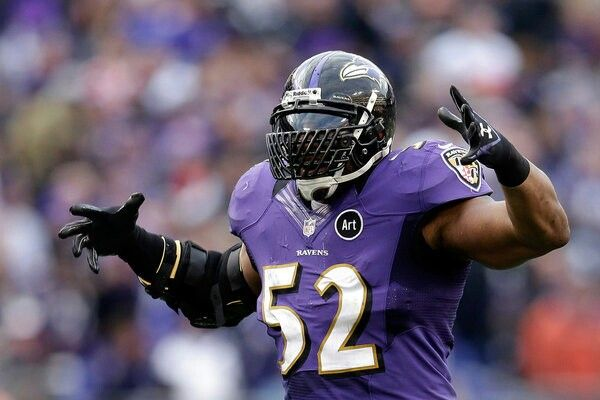

3-Gramilla: Por ultimo, ha seleccionado el tipo de gramilla. Ya vimos como el tipo de gramilla influye en las jugadas. Tiene sentido utilizarla para el modelo.

## Regression

In [74]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split


#Utilizamos las variables seleccionadas en el metodo anterior
features = ['PlayType_Field Goal', 'PlayType_Kickoff Not Returned', 'PlayType_Pass', 'PlayType_Punt Not Returned', 'RosterPosition_Cornerback','RosterPosition_Linebacker','RosterPosition_Running Back', 'RosterPosition_Wide Receiver', 'Surface_Natural', 'Surface_Synthetic' ]
X = final_df_int[features]
#Seleccionamos la variable objetivo
y = final_df_int['Injury']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
lf = LogisticRegression(random_state=0).fit(X_train, y_train)
y_pred_log = lf.predict(X_test)
lf.score(X_test, y_test)

1.0

Hemos obtenido un 1, lo cual indica overfitting.

Train accuracy: 1.0
Test accuracy: 1.0


Text(0.5, 733.3155555555555, 'Predicted label')

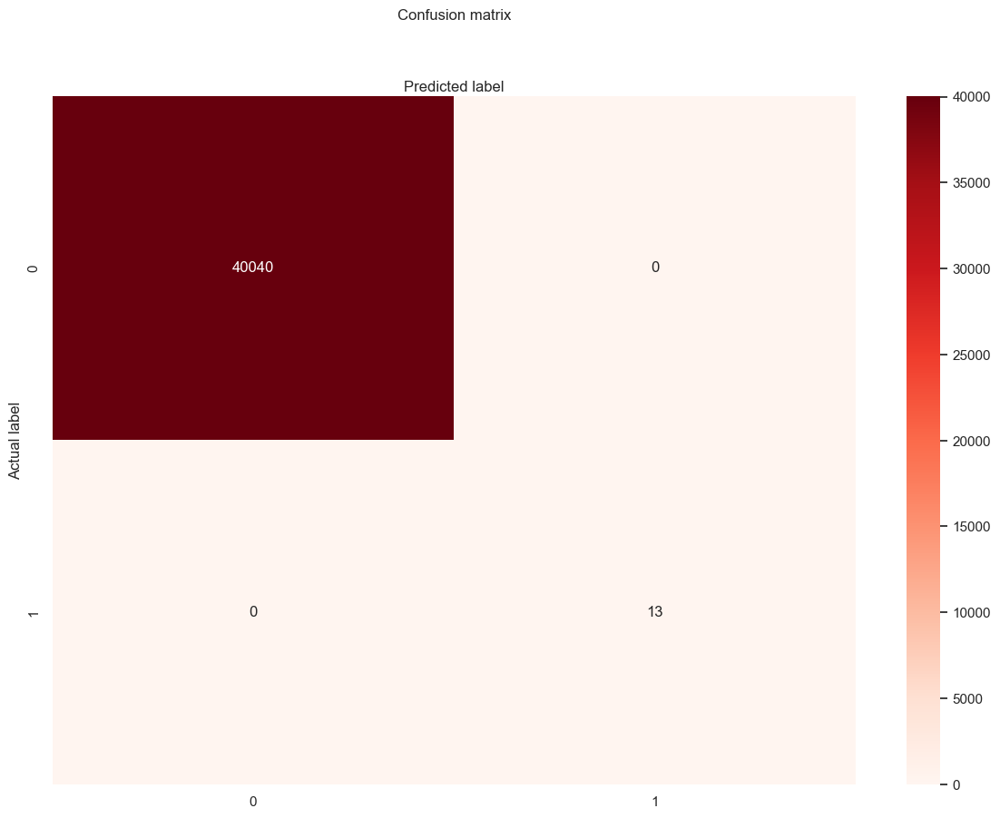

In [106]:
from sklearn import metrics
import matplotlib.pylab as plt
from sklearn.metrics import accuracy_score


y_pred = lf.predict(X_test) # Predictions
y_true = y_test # True values

print("Train accuracy:", np.round(accuracy_score(y_train, lf.predict(X_train)), 2))
print("Test accuracy:", np.round(accuracy_score(y_true, y_pred), 2))

cnf_matrix = metrics.confusion_matrix(y_test, y_pred_log)
#cnf_matrix

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="Reds" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

### Prueba con menos variables para reducir overfitting

He decidido limitar el output de SelectKBest a 6, obteniendo las siguientes variables:

PlayType_Kickoff Not Returned, 
PlayType_Kickoff Returned, 
PlayType_Pass, 
PlayType_Punt, 
PlayType_Punt Not Returned, 
PlayType_Punt Returned, 

In [75]:
#Utilizamos las variables seleccionadas en el metodo anterior
features = ['PlayType_Kickoff Returned', 'PlayType_Kickoff Not Returned', 'PlayType_Pass', 'PlayType_Punt Not Returned', 'PlayType_Punt', 'PlayType_Punt Returned']
X = final_df_int[features]
#Seleccionamos la variable objetivo
y = final_df_int['Injury']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
lf = LogisticRegression(random_state=0).fit(X_train, y_train)
y_pred_log = lf.predict(X_test)
lf.score(X_test, y_test)

0.9996754300551769

Ha mejorado algo, pero el rersultado sigue siendo demasiado alto.

## Tuneo de Hyperparametros

In [100]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split


#Utilizamos las variables seleccionadas en el metodo anterior
features = ['PlayType_Field Goal', 'PlayType_Kickoff Not Returned', 'PlayType_Pass', 'PlayType_Punt Not Returned', 'RosterPosition_Cornerback','RosterPosition_Linebacker','RosterPosition_Running Back', 'RosterPosition_Wide Receiver', 'Surface_Natural', 'Surface_Synthetic' ]
X = final_df_int[features]
#Seleccionamos la variable objetivo
y = final_df_int['Injury']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
lf = LogisticRegression(random_state=0, C = 1000).fit(X_train, y_train)
y_pred_log = lf.predict(X_test)
lf.score(X_test, y_test)

1.0

Text(0.5, 733.3155555555555, 'Predicted label')

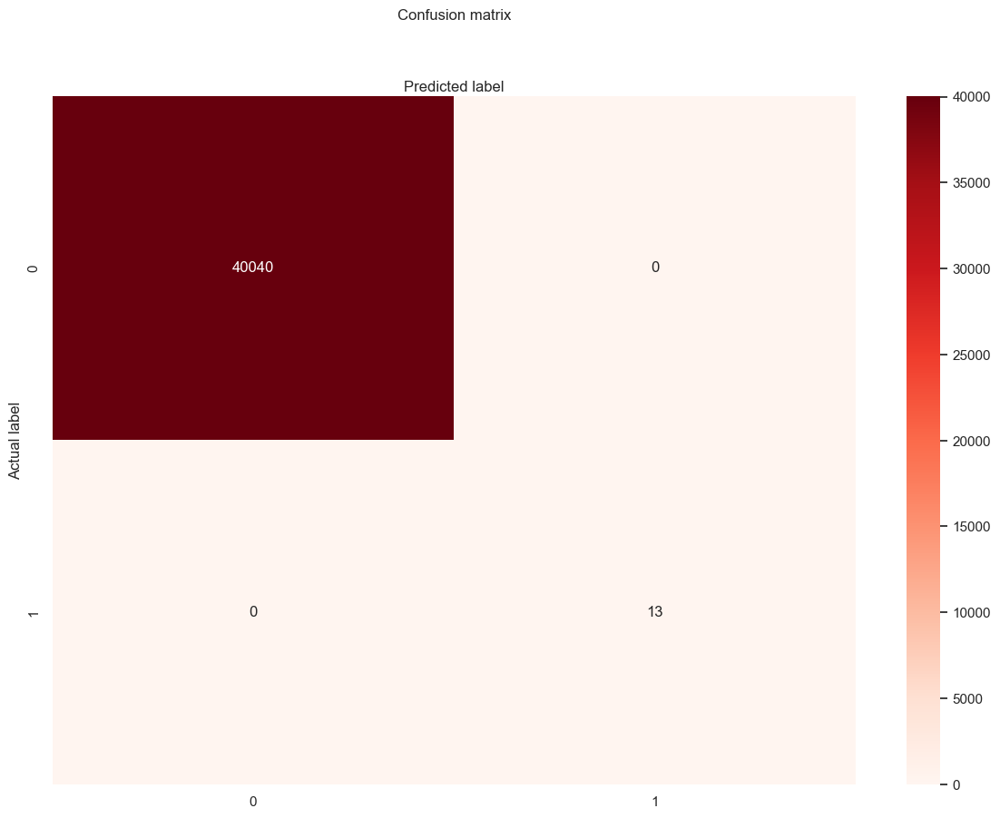

In [101]:
cnf_matrix = metrics.confusion_matrix(y_test, y_pred_log)
#cnf_matrix

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="Reds" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

Probe con diferentes solvers y valores de C pero sin suerte alguna.

## Conclusion

Después de revisar y analizar mi modelo, creo que cometí un error al crear las variables dummy. No estoy seguro de cómo afectó al modelo el hecho de que todas las variables fueran dicotómicas, y siento que necesito mejorar mis habilidades en la selección de hiperparámetros. Aunque probé varias opciones, que no se reflejan en el código para no complicar, siento que podría haber hecho más.

Este proyecto ha sido el más gratificante del máster hasta ahora a pesar de que no obtuve resultados positivos. Es la primera vez que he tenido la oportunidad de crear un modelo en un área que conozco bien, y siento que estaba en el camino correcto. He aprendido mucho y agradezco que nos haya animado a probar algo diferente.

Si hubiera tenido más tiempo, probablemente hubiera encontrado una solución, pero definitivamente lo retomaré como proyecto personal.

¡Muchas gracias por tus enseñanzas, Juan José!